# 1D/2D analysis

In [1]:
# import required modules
import pickle5
import pandas as pd
import numpy as np

In [2]:
DataPath = "../" # the folder containing the required files
OptFN = "{}options_full.ini".format(DataPath)

In [3]:
#### FUNCTIONS ####
# get run parameters from options file	
def get_Options(OptFN, OptionsDic, AllowedPars):
    try:
        optionsfile=open(OptFN, "r")
        for line in optionsfile :
            if line[:1] != "#" and len(line.strip("\n".strip(""))) > 1 :
                splitted_line = line.split(":")
                key=splitted_line[0].split(" ")[0]
                value=splitted_line[1].strip("\n").split(" ")[0]
                if key in AllowedPars :
                    OptionsDic[key] = value 
    except:
        print('Error reading %s file !' % (OptFN))

    return OptionsDic

#retrieve list of lists based on 2 separators
def double_split(Text, sep1, sep2):
    # further parse options
    WholeL = []
    MainL = Text.split(sep1)
    for text in MainL:
        WholeL.append(text.strip().split(sep2))

    return WholeL


In [4]:
## load required data
# the options
OptionsDic = {}
AllowedPars = ["Partners"]
OptionsDic = get_Options(OptFN, OptionsDic, AllowedPars)
ComplexesL = double_split(OptionsDic["Partners"], ";", "~")[0]
# the AAvarsDic
AAvarsDic = {} 
GlobalAAvarsDic = {}
with open(r"{}SR_AAvars_{}_vs_{}.pkl".format(DataPath,ComplexesL[0], ComplexesL[1]), "rb") as input_file:
    GlobalAAvarsDic = pickle5.load(input_file)
    
## Drop irrelevant information
for complex in GlobalAAvarsDic.keys():
    AAvarsDic = GlobalAAvarsDic[complex]
    for key in AAvarsDic.keys():
        del AAvarsDic[key]['IndBCData']
    
    print("{} single mutant combinations found in SR_AAvars dictionary for complex partners {} (A) and {} (B) !".format(len(AAvarsDic.keys()), ComplexesL[0], ComplexesL[1]))

10956 single mutant combinations found in SR_AAvars dictionary for complex partners VN1551_VHH2 (A) and VN1554_TNFa-2 (B) !


In [5]:
dMutL = list(AAvarsDic.keys()) # list of 2D variant combination
# remove double mutants supported by less than Min_dBCs and SD more than NormEnrichFactor
Min_dBCs = 2
MaxSD_NormEnrichFactor = 0.8
for key in dMutL:
    if ( AAvarsDic[key]['Stats'][2] >= Min_dBCs ) and ( AAvarsDic[key]['Stats'][1] <= (AAvarsDic[key]['Stats'][0] * MaxSD_NormEnrichFactor )):
        AAvarsDic[key] = AAvarsDic[key]['Stats'] # Normalized enrichment, SD and diffent BCs supporting the combination of variants
    else:
        del AAvarsDic[key]


In [6]:
# print some information to see if everything is fine
i = 1
for key in AAvarsDic.keys():
    if i <= 3:
        print("{}:{}".format(key, AAvarsDic[key]))
        i += 1

Y35A:Q88K:[0.3324051569820905, 0.07833378544510669, 4]
N31E:L75G:[0.3874054823790009, 0.13775684010620373, 3]
I57V:WT:[1.023368311213879, 0.14569355647951418, 149]


In [7]:
# evaluate number of mutants / partner and the maximum number of theoretical combinations
pA_Vars = set()
pB_Vars = set()
for key in AAvarsDic.keys():
    key_split = key.split(":")
    pA_Vars.add(key_split[0])
    pB_Vars.add(key_split[1])

pA_VarsL = list(pA_Vars)
pA_PosL = [int(var[1:-1]) if var != "WT" else 0 for var in pA_VarsL]
pB_VarsL = list(pB_Vars)
pB_PosL = [int(var[1:-1]) if var != "WT" else 0 for var in pB_VarsL]

Tcomb = len(pA_VarsL) * len(pB_VarsL) 
print("Total number of mutation in partner A: {}\nTotal number of mutation in partner B: {}\nMaximum theoretical number of 2D mutants: {}".format(len(pA_VarsL),len(pB_VarsL), Tcomb))

Total number of mutation in partner A: 122
Total number of mutation in partner B: 104
Maximum theoretical number of 2D mutants: 12688


In [8]:
# take position of an mutation
def takePos(muta):
    if muta != "WT":
        pos = int(muta[1:-1])
    else:
        pos = 0
    return pos

pA_Vars = set()
pB_Vars = set()
for key in AAvarsDic.keys():
    key_split = key.split(":")
    pA_Vars.add(key_split[0])
    pB_Vars.add(key_split[1])

pA_VarsL = PB_VarsL = []

pA_VarsL = list(pA_Vars)
pA_VarsL.sort(key=takePos)

pB_VarsL = list(pB_Vars)
pB_VarsL.sort(key=takePos)

In [9]:
# construct the pandas dataframe scaffold
AAvarsDF = pd.DataFrame(index=pA_VarsL, columns=pB_VarsL)
AAvarsSdDF = pd.DataFrame(index=pA_VarsL, columns=pB_VarsL)
AAvarsNdBCsDF = pd.DataFrame(index=pA_VarsL, columns=pB_VarsL)
AAvarsDF.shape

(122, 104)

In [10]:
# fill pandas dataframes (DF) with values
#enrichment DF
for key in AAvarsDic.keys():
    key_split = key.split(":")
    AAvarsDF.loc[key_split[0]][key_split[1]] = AAvarsDic[key][0]
#Standard deviation DF
for key in AAvarsDic.keys():
    key_split = key.split(":")
    AAvarsSdDF.loc[key_split[0]][key_split[1]] = AAvarsDic[key][1]
#Number of barcodes DF
for key in AAvarsDic.keys():
    key_split = key.split(":")
    AAvarsNdBCsDF.loc[key_split[0]][key_split[1]] = AAvarsDic[key][2]

In [11]:
AAvarsSdDF.head(10)

,WT,R32D,R32F,R32K,R32N,L75G,L75F,L75W,L75I,L75M,...,E146L,S147N,S147M,S147F,S147T,S147E,S147D,S147K,S147G,S147L
WT,0.280834,0.360511,0.23487,0.276151,0.327855,0.168185,0.415444,0.307319,0.267671,0.321664,...,0.147814,0.185272,0.153633,0.235486,0.154807,0.387532,0.468021,0.206102,0.25404,0.33494
S30R,0.186665,NaN,0.03021,0.109499,NaN,0.181379,0.458014,0.144442,0.240737,0.295278,...,0.109202,0.394844,0.396509,0.055291,0.617092,NaN,0.058589,0.276611,0.42216,0.036833
S30L,0.231614,0.191243,NaN,0.420196,NaN,0.020769,0.294963,NaN,NaN,0.108375,...,0.117126,0.042798,NaN,0.234338,NaN,NaN,0.165077,0.025679,0.033494,0.021399
S30K,0.247644,NaN,0.027513,0.133331,NaN,0.330154,NaN,NaN,NaN,0.890193,...,0.002093,NaN,NaN,0.608283,NaN,NaN,NaN,0.962949,NaN,0.285087
S30G,0.231018,0.601843,0.053333,0.148316,NaN,0.097118,0.303306,0.418674,0.19259,0.780512,...,0.046539,0.053497,0.217199,0.091143,0.158752,0.528246,NaN,0.283485,0.20935,0.03824
S30D,0.160955,NaN,0.316432,NaN,0.519993,0.258905,0.622707,NaN,NaN,0.38952,...,0.055077,NaN,NaN,0.0,NaN,0.169479,NaN,0.998124,0.444703,0.336821
S30E,0.29543,NaN,0.17208,0.012839,NaN,0.166962,0.131125,0.513573,NaN,0.0,...,0.199997,0.492525,0.148066,0.357667,0.18189,0.207569,NaN,0.029629,0.166453,NaN
S30F,0.205494,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.626314,...,0.057316,NaN,NaN,0.0,0.077036,0.082539,NaN,NaN,NaN,0.207404
S30N,0.327179,NaN,0.435768,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.048432,NaN,NaN,0.503102,NaN,NaN,NaN,NaN,0.201761,0.0777
N31D,0.150951,0.491104,0.038602,0.03646,NaN,0.110898,0.104206,NaN,0.256786,0.065692,...,0.011594,0.364185,0.051073,0.147361,0.431493,0.363867,0.165527,0.059917,0.006294,0.060528


In [12]:
# prepare useful data for plotting
Enrich = AAvarsDF.transpose().to_numpy()
Sd = AAvarsSdDF.transpose().to_numpy()
NdBCs = AAvarsNdBCsDF.transpose().to_numpy()
tAAvarsDF = AAvarsDF.transpose()

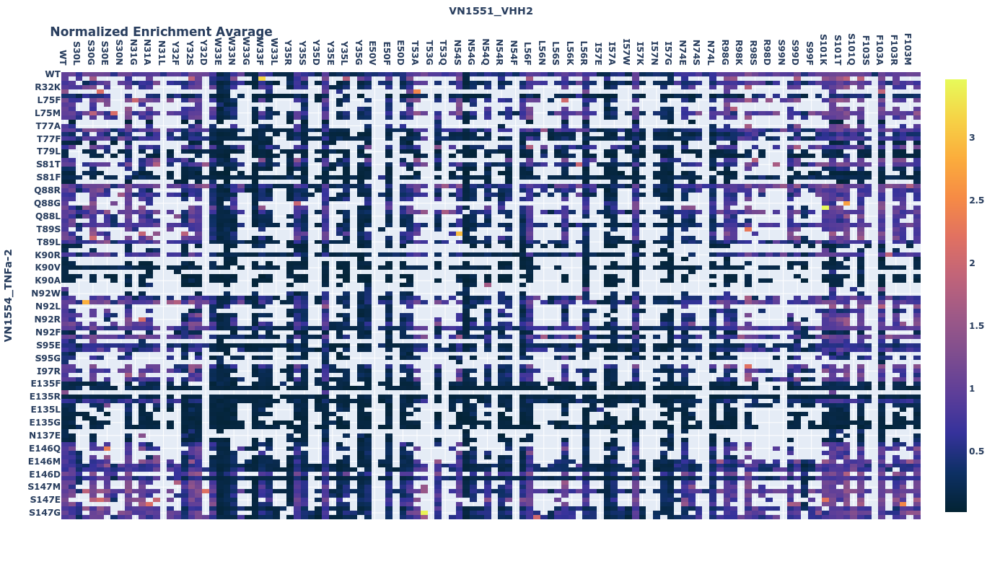

In [13]:
# graphics plotting
import plotly.graph_objects as go
import plotly.colors as go_colours
heatmap_trace = go.Heatmap(
                    z = tAAvarsDF,
                    x = tAAvarsDF.columns,
                    y = tAAvarsDF.index,
                    customdata = np.stack((Enrich, Sd, NdBCs), axis=-1),
                    hovertemplate=('<b>{} '.format(ComplexesL[0]) + '(%{x})' + '<BR>{} '.format(ComplexesL[1]) + 
                                   '(%{y})</b><BR><BR>Enrichment: %{customdata[0]:,.2f}' + '<BR>sd: %{customdata[1]:,.3f}' + '<BR>Nbr_dBCs: %{customdata[2]}' +
                                   '<extra></extra>'),
                    hoverongaps = False,
                    colorscale=go_colours.sequential.thermal
                     )

fig = go.Figure(heatmap_trace)
fig['layout'].update(title='Normalized Enrichment Avarage', 
                     yaxis={"title": ComplexesL[1]},
                     xaxis={"title": ComplexesL[0]}, 
                     width=1200,
                     height=800,
                     autosize=False,
                     
                    )
fig['layout']['yaxis']['autorange'] = "reversed"
fig.update_xaxes(side="top")
fig.show()


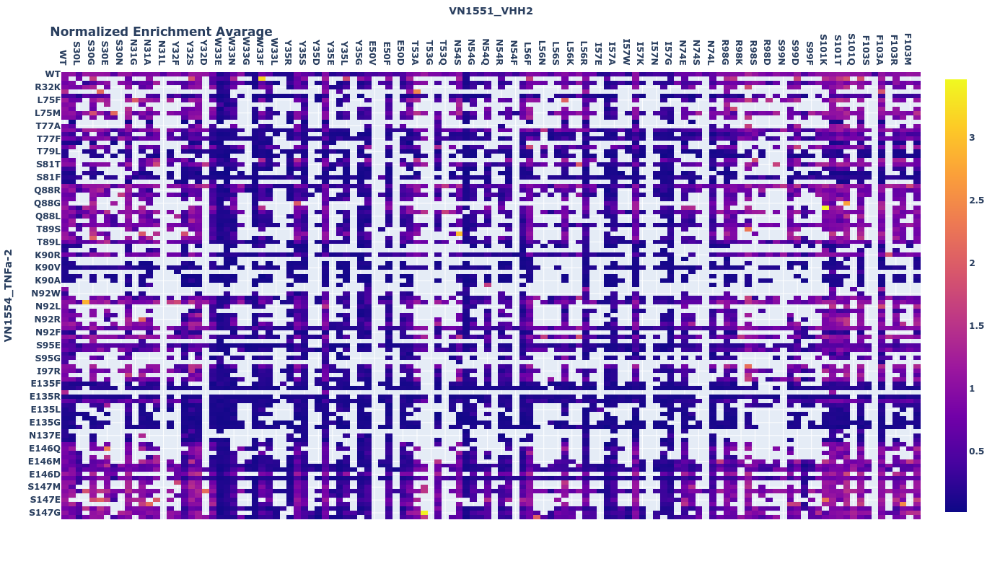

In [14]:
# graphics plotting
# Color sequential minus
import plotly.graph_objects as go
import plotly.colors as go_colours
heatmap_trace = go.Heatmap(
                    z = tAAvarsDF,
                    x = tAAvarsDF.columns,
                    y = tAAvarsDF.index,
                    customdata = np.stack((Enrich, Sd, NdBCs), axis=-1),
                    hovertemplate=('<b>{} '.format(ComplexesL[0]) + '(%{x})' + '<BR>{} '.format(ComplexesL[1]) + 
                                   '(%{y})</b><BR><BR>Enrichment: %{customdata[0]:,.2f}' + '<BR>sd: %{customdata[1]:,.3f}' + '<BR>Nbr_dBCs: %{customdata[2]}' +
                                   '<extra></extra>'),
                    hoverongaps = False,
                    colorscale =[[0.0, '#0d0887'], 
                                 [0.1111111111111111,'#46039f'],
                                 [0.2222222222222222, '#7201a8'],
                                 [0.3333333333333333, '#9c179e'],
                                 [0.4444444444444444, '#bd3786'],
                                 [0.5555555555555556, '#d8576b'],
                                 [0.6666666666666666, '#ed7953'],
                                 [0.7777777777777778, '#fb9f3a'],
                                 [0.8888888888888888, '#fdca26'], 
                                 [1.0,'#f0f921']],
                     )

fig = go.Figure(heatmap_trace)
fig['layout'].update(title='Normalized Enrichment Avarage', 
                     yaxis={"title": ComplexesL[1]},
                     xaxis={"title": ComplexesL[0]}, 
                     width=1200,
                     height=800,
                     autosize=False,
                     
                    )
fig['layout']['yaxis']['autorange'] = "reversed"
fig.update_xaxes(side="top")
fig.show()


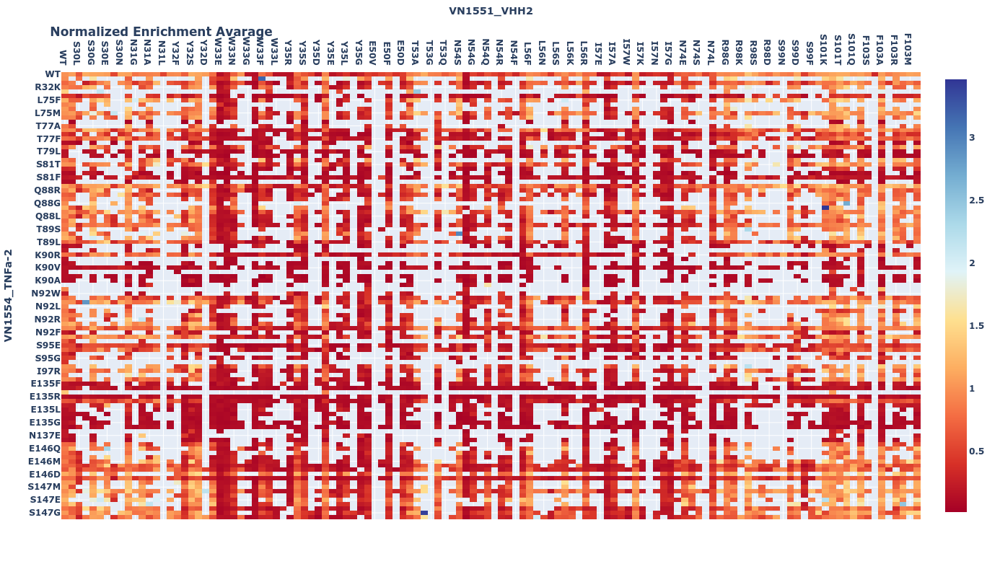

In [15]:
# graphics plotting
# Color Sequential from red to blue
import plotly.graph_objects as go
import plotly.colors as go_colours
heatmap_trace = go.Heatmap(
                    z = tAAvarsDF,
                    x = tAAvarsDF.columns,
                    y = tAAvarsDF.index,
                    customdata = np.stack((Enrich, Sd, NdBCs), axis=-1),
                    hovertemplate=('<b>{} '.format(ComplexesL[0]) + '(%{x})' + '<BR>{} '.format(ComplexesL[1]) + 
                                   '(%{y})</b><BR><BR>Enrichment: %{customdata[0]:,.2f}' + '<BR>sd: %{customdata[1]:,.3f}' + '<BR>Nbr_dBCs: %{customdata[2]}' +
                                   '<extra></extra>'),
                    hoverongaps = False,
                    colorscale=[[0.0, "rgb(165,0,38)"],
                [0.1111111111111111, "rgb(215,48,39)"],
                [0.2222222222222222, "rgb(244,109,67)"],
                [0.3333333333333333, "rgb(253,174,97)"],
                [0.4444444444444444, "rgb(254,224,144)"],
                [0.5555555555555556, "rgb(224,243,248)"],
                [0.6666666666666666, "rgb(171,217,233)"],
                [0.7777777777777778, "rgb(116,173,209)"],
                [0.8888888888888888, "rgb(69,117,180)"],
                [1.0, "rgb(49,54,149)"]]
                     )

fig = go.Figure(heatmap_trace)
fig['layout'].update(title='Normalized Enrichment Avarage', 
                     yaxis={"title": ComplexesL[1]},
                     xaxis={"title": ComplexesL[0]}, 
                     width=1200,
                     height=800,
                     autosize=False,
                     
                    )
fig['layout']['yaxis']['autorange'] = "reversed"
fig.update_xaxes(side="top")
fig.show()

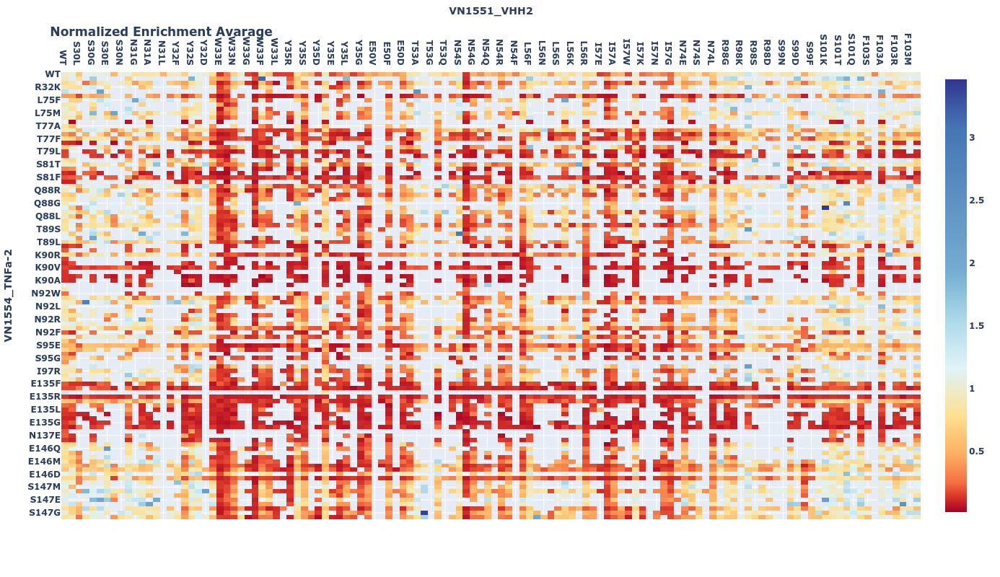

In [16]:
# graphics plotting
# Color not Sequential from red to blue
import plotly.graph_objects as go
import plotly.colors as go_colours
heatmap_trace = go.Heatmap(
                    z = tAAvarsDF,
                    x = tAAvarsDF.columns,
                    y = tAAvarsDF.index,
                    customdata = np.stack((Enrich, Sd, NdBCs), axis=-1),
                    hovertemplate=('<b>{} '.format(ComplexesL[0]) + '(%{x})' + '<BR>{} '.format(ComplexesL[1]) + 
                                   '(%{y})</b><BR><BR>Enrichment: %{customdata[0]:,.2f}' + '<BR>sd: %{customdata[1]:,.3f}' + '<BR>Nbr_dBCs: %{customdata[2]}' +
                                   '<extra></extra>'),
                    hoverongaps = False,
                    colorscale=[[0.0, "rgb(165,0,38)"],
                [0.0333333333333333, "rgb(215,48,39)"],
                [0.0666666666666666, "rgb(244,109,67)"],
                [0.1333333333333333, "rgb(253,174,97)"],
                [0.2222222222222222, "rgb(254,224,144)"],
                [0.3333333333333333, "rgb(224,243,248)"],
                [0.4444444444444444, "rgb(171,217,233)"],
                [0.5555555555555555, "rgb(116,173,209)"],
                [0.8888888888888888, "rgb(69,117,180)"],
                [1.0, "rgb(49,54,149)"]]
                     )

fig = go.Figure(heatmap_trace)
fig['layout'].update(title='Normalized Enrichment Avarage', 
                     yaxis={"title": ComplexesL[1]},
                     xaxis={"title": ComplexesL[0]}, 
                     width=1200,
                     height=800,
                     autosize=False,
                     
                    )
fig['layout']['yaxis']['autorange'] = "reversed"
fig.update_xaxes(side="top")
fig.show()

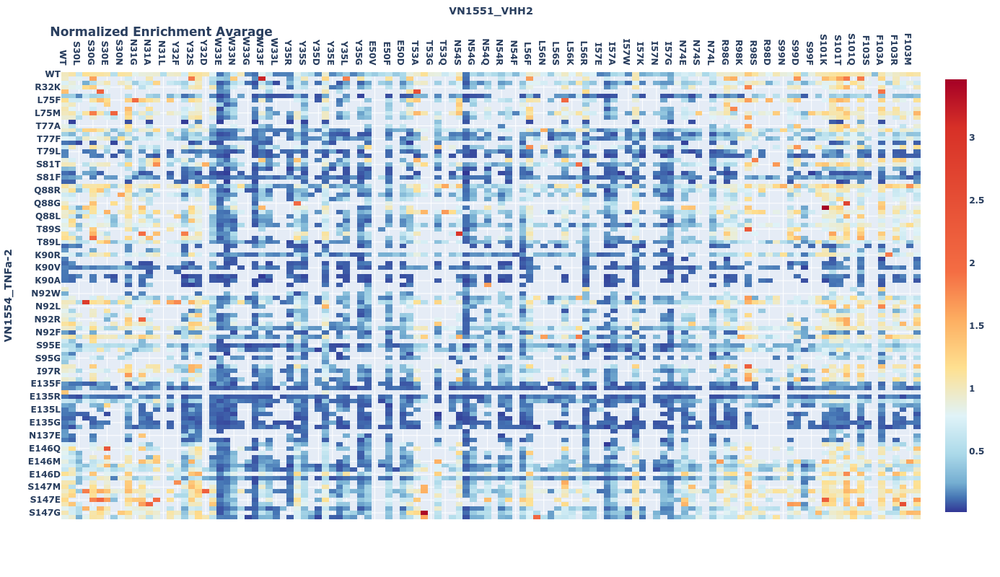

In [17]:
# graphics plotting
# Color not Sequential from blue to red
import plotly.graph_objects as go
import plotly.colors as go_colours
heatmap_trace = go.Heatmap(
                    z = tAAvarsDF,
                    x = tAAvarsDF.columns,
                    y = tAAvarsDF.index,
                    customdata = np.stack((Enrich, Sd, NdBCs), axis=-1),
                    hovertemplate=('<b>{} '.format(ComplexesL[0]) + '(%{x})' + '<BR>{} '.format(ComplexesL[1]) + 
                                   '(%{y})</b><BR><BR>Enrichment: %{customdata[0]:,.2f}' + '<BR>sd: %{customdata[1]:,.3f}' + '<BR>Nbr_dBCs: %{customdata[2]}' +
                                   '<extra></extra>'),
                    hoverongaps = False,
                    colorscale=[[0.0, "rgb(49,54,149)"],
                [0.0333333333333333, "rgb(69,117,180)"],
                [0.0666666666666666, "rgb(116,173,209)"],
                [0.1333333333333333, "rgb(171,217,233)"],
                [0.2222222222222222, "rgb(224,243,248)"],
                [0.3333333333333333, "rgb(254,224,144)"],
                [0.4444444444444444, "rgb(253,174,97)"],
                [0.5555555555555555, "rgb(244,109,67)"],
                [0.8888888888888888, "rgb(215,48,39)"],
                [1.0, "rgb(165,0,38)"]]
                     )

fig = go.Figure(heatmap_trace)
fig['layout'].update(title='Normalized Enrichment Avarage', 
                     yaxis={"title": ComplexesL[1]},
                     xaxis={"title": ComplexesL[0]}, 
                     width=1200,
                     height=800,
                     autosize=False,
                     
                    )
fig['layout']['yaxis']['autorange'] = "reversed"
fig.update_xaxes(side="top")
fig.show()

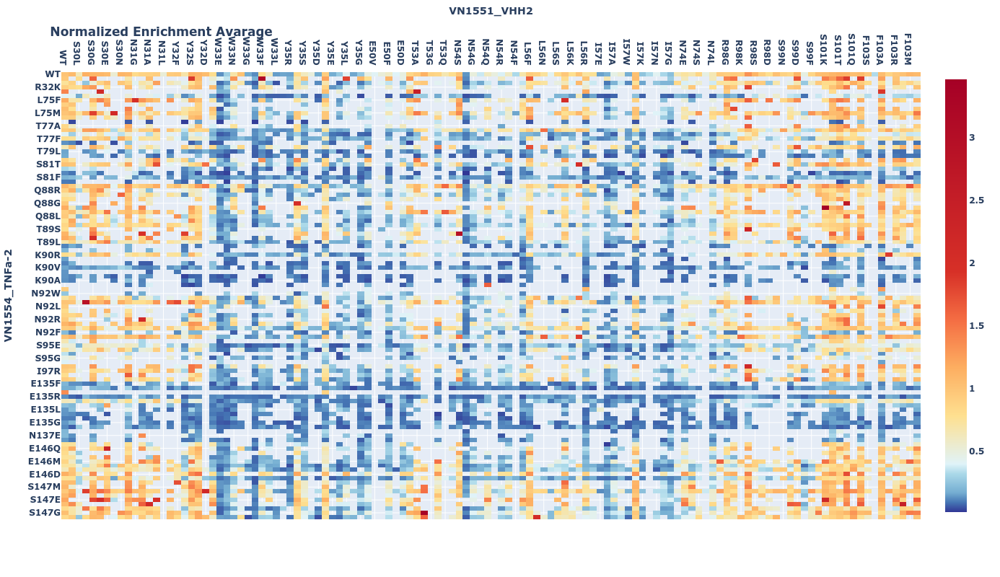

In [18]:
# graphics plotting
# Color not Sequential from blue to red
import plotly.graph_objects as go
import plotly.colors as go_colours
heatmap_trace = go.Heatmap(
                    z = tAAvarsDF,
                    x = tAAvarsDF.columns,
                    y = tAAvarsDF.index,
                    customdata = np.stack((Enrich, Sd, NdBCs), axis=-1),
                    hovertemplate=('<b>{} '.format(ComplexesL[0]) + '(%{x})' + '<BR>{} '.format(ComplexesL[1]) + 
                                   '(%{y})</b><BR><BR>Enrichment: %{customdata[0]:,.2f}' + '<BR>sd: %{customdata[1]:,.3f}' + '<BR>Nbr_dBCs: %{customdata[2]}' +
                                   '<extra></extra>'),
                    hoverongaps = False,
                    colorscale=[[0.0, "rgb(49,54,149)"],
                [0.0222222222222222, "rgb(69,117,180)"],
                [0.0444444444444444, "rgb(116,173,209)"],
                [0.0888888888888888, "rgb(171,217,233)"],
                [0.1111111111111111, "rgb(224,243,248)"],
                [0.2222222222222222, "rgb(254,224,144)"],
                [0.3333333333333333, "rgb(253,174,97)"],
                [0.4444444444444444, "rgb(244,109,67)"],
                [0.5555555555555555, "rgb(215,48,39)"],
                [1.0, "rgb(165,0,38)"]]
                     )

fig = go.Figure(heatmap_trace)
fig['layout'].update(title='Normalized Enrichment Avarage', 
                     yaxis={"title": ComplexesL[1]},
                     xaxis={"title": ComplexesL[0]}, 
                     width=1200,
                     height=800,
                     autosize=False,
                     
                    )
fig['layout']['yaxis']['autorange'] = "reversed"
fig.update_xaxes(side="top")
fig.show()

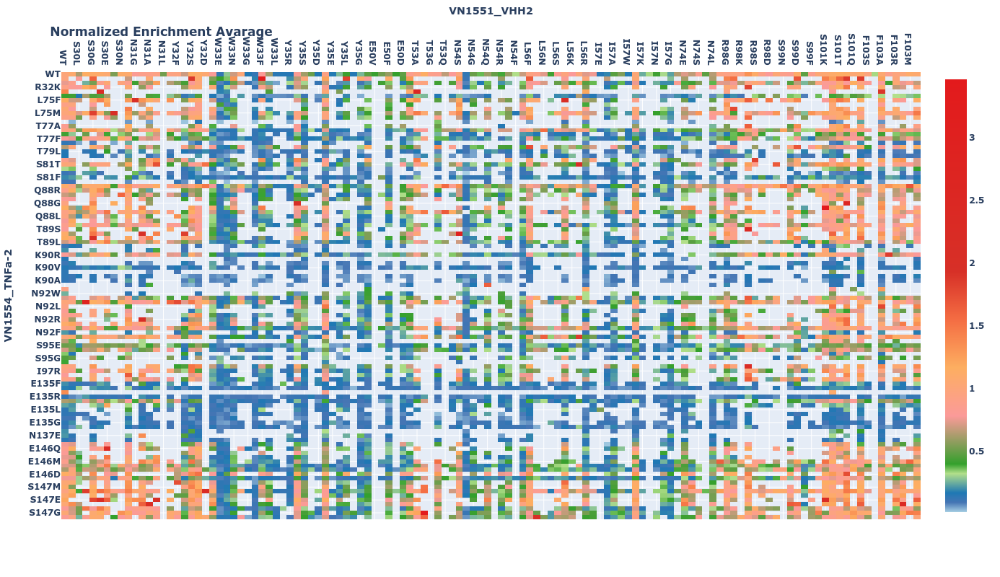

In [19]:
# graphics plotting
import plotly.graph_objects as go
import plotly.colors as go_colours
heatmap_trace = go.Heatmap(
                    z = tAAvarsDF,
                    x = tAAvarsDF.columns,
                    y = tAAvarsDF.index,
                    customdata = np.stack((Enrich, Sd, NdBCs), axis=-1),
                    hovertemplate=('<b>{} '.format(ComplexesL[0]) + '(%{x})' + '<BR>{} '.format(ComplexesL[1]) + 
                                   '(%{y})</b><BR><BR>Enrichment: %{customdata[0]:,.2f}' + '<BR>sd: %{customdata[1]:,.3f}' + '<BR>Nbr_dBCs: %{customdata[2]}' +
                                   '<extra></extra>'),
                    hoverongaps = False,   
                    colorscale=[[0.0, "rgb(166,206,227)"],
                        [0.0222222222222222, "rgb(69,117,180)"],
                        [0.0444444444444444, "rgb(31,120,180)"],
                        [0.0888888888888888, "rgb(178,223,138)"],
                        [0.1111111111111111, "rgb(51,160,44)"],
                        [0.2222222222222222, "rgb(251,154,153)"],
                        [0.3333333333333333, "rgb(253,174,97)"],
                        [0.4444444444444444, "rgb(244,109,67)"],
                        [0.5555555555555555, "rgb(215,48,39)"],
                        [1.0, "rgb(227,26,28)"]]
                     )

fig = go.Figure(heatmap_trace)
fig['layout'].update(title='Normalized Enrichment Avarage', 
                     yaxis={"title": ComplexesL[1]},
                     xaxis={"title": ComplexesL[0]}, 
                     width=1200,
                     height=800,
                     autosize=False,
                     
                    )
fig['layout']['yaxis']['autorange'] = "reversed"
fig.update_xaxes(side="top")
fig.show()

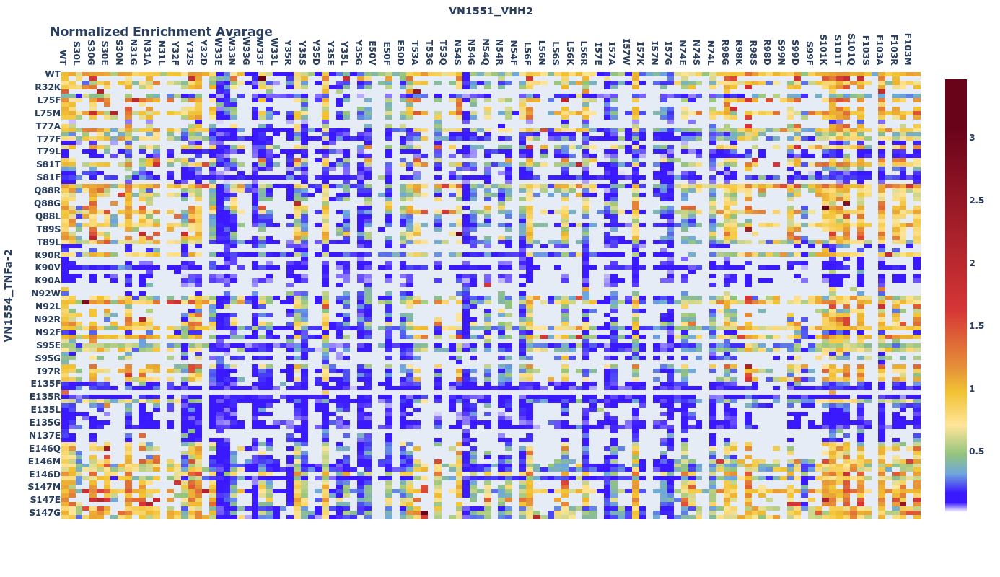

In [20]:
# graphics plotting
# Derived from Raph colors
import plotly.graph_objects as go
import plotly.colors as go_colours
heatmap_trace = go.Heatmap(
                    z = tAAvarsDF,
                    x = tAAvarsDF.columns,
                    y = tAAvarsDF.index,
                    customdata = np.stack((Enrich, Sd, NdBCs), axis=-1),
                    hovertemplate=('<b>{} '.format(ComplexesL[0]) + '(%{x})' + '<BR>{} '.format(ComplexesL[1]) + 
                                   '(%{y})</b><BR><BR>Enrichment: %{customdata[0]:,.2f}' + '<BR>sd: %{customdata[1]:,.3f}' + '<BR>Nbr_dBCs: %{customdata[2]}' +
                                   '<extra></extra>'),
                    hoverongaps = False, 
                    colorscale=[[0.0, "white"],
                        [0.0222222222222222, '#3b19ff'],
                        [0.0444444444444444, '#3b19ff'],
                        [0.0888888888888888, '#6fa8dc'],
                        [0.1333333333333333, '#93c47d'],
                        [0.2000000000000000, '#ffe599'],
                        [0.2777777777777777, '#f1c232'],
                        [0.3333333333333333, '#e69138'],
                        [0.4666666666666666, '#d63636'],        
                        [0.8888888888888888, '#69031a'], 
                        [1, '#69031a']]
                     )

fig = go.Figure(heatmap_trace)
fig['layout'].update(title='Normalized Enrichment Avarage', 
                     yaxis={"title": ComplexesL[1]},
                     xaxis={"title": ComplexesL[0]}, 
                     width=1200,
                     height=800,
                     autosize=False,
                     
                    )
fig.update_layout(xaxis_showgrid=False, yaxis_showgrid=False)
fig['layout']['yaxis']['autorange'] = "reversed"
fig.update_xaxes(side="top")
fig.show()

In [21]:
# print mutant related general information
print(AAvarsDic["W33R:N92D"])

[0.5317265029348482, 0.11034887139806233, 13]


In [22]:
# prepare to print mutant barcode specific information 
WholeAAvarsDic = GlobalAAvarsDic[complex]

In [23]:
# print mutant combination related barcodes and their normalized enrichment
print(WholeAAvarsDic["W33R:N92D"])

[0.5317265029348482, 0.11034887139806233, 13]


In [24]:
print(WholeAAvarsDic["W33R:WT"])

[0.12334383285318813, 0.04871345301994174, 133]


In [25]:
print(WholeAAvarsDic["WT:N92D"])

[0.9348320424947547, 0.19905498618382542, 145]
